# Datenanalyse Case Study Spotify 24.09.2025

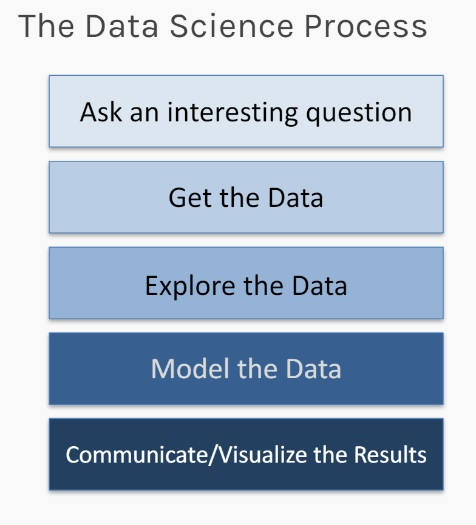

Quelle: Protopapas, Rader, Tanner, CS109 Data Science, 2020 [Link](https://github.com/Harvard-IACS/2020-CS109A/blob/master/content/lectures/lecture01/slides/Lecture1_Introduction.pdf)

In diesem Notebook analysieren wir einen einfachen Datensatz anhand der einzelnen Schritte des bekannten Data Science Workflows aus der Vorlesung.

Als Datensatz nehmen wir einen Datensatz von Spotify. Es handelt sich hier wie gesagt um einen recht einfachen Datensatz, in der Realität haben Sie meist viel mehr Daten, Features und vor allem Data und Feature Engineering zu tun, um gute Ergebnisse zu erhalten.

## Schritt 1: Ask an interesting question

Der Beginn eines jeden Use Case Data Science ist die Festlegung, welche Fragestellungen wir untersuchen wollen.

Der Datensatz ist recht einfach, weshalb sich nur wenige Fragestellungen ansehen lassen. Aber für den Einstieg ist das in Ordnung.

Mögliche Fragestellungen wären:
- Was sind die populärsten Lieder? Was sind die unpopulärsten?
- Was für Eigenschaften haben sehr populäre/ nicht populäre Lieder?
- Sind populäre Lieder kürzer?

Bei den ersten beiden Fragen untersuchen wir **eine** definierte Variable, eine sogenannte **univariate Datenanalyse**.

Die Variablen werden auch **Features** genannt. Damit kann man erste Untersuchungen anstellen, für die meisten interessanten Fragestellungen muß man sich jedoch mehr als ein Feature ansehen. Man spricht dann von **multivariater Datenanalyse**.

Im späteren Verlauf der Vorlesung werden wir auch Hypothesen bilden und diese mittels Daten belegen oder widerlegen. Ein Beispiel wäre:

Hypothese 1: Lieder mit expliziten Lyrics sind populärer




## Schritt 2: Get the Data

Nachdem wir uns die zu untersuchenden Fragestellungen definiert haben, beschaffen wir uns die Daten.

Für das Laden und Auswerten der Daten gibt es in Python viele Programmbibliotheken, die uns die Detailarbeit abnehmen.

Am Beginn jedes Notebooks laden wir diese Libraries, den Code sehen Sie in der grauen Zelle unter dieser Zeile. Lila markierter Text sind Standard-Befehle der Programmiersprache Python, Kommentare werden mit einer Raute eingeleitet.

Gute, kostenfreie Kurse in Python sind in den Literaturquellen in der Vorlesung angegeben; Sie benötigen diese aber eigentlich nicht für die Umfänge der Vorlesung.

In [1]:
import pandas as pd   # Importieren Standard-Library für das Bearbeiten und Laden von Daten ("Data Engineering").
import matplotlib.pyplot as plt # Standard-Library für das Plotten von Graphen.
import seaborn as sns   # verschönert Matplotlib-Graphiken
import numpy as np # Standard-Library für Rechnen

In [2]:
# Importiere die notwendigen Bibliotheken
from google.colab import files # Für das Hochladen von Dateien in Colab
import pandas as pd             # Für die Datenmanipulation und -analyse

# Ermögliche das Hochladen einer Datei
# Es wird ein Dialogfenster geöffnet, in dem du die CSV-Datei auswählen kannst.
uploaded = files.upload()

# Verarbeite die hochgeladene(n) Datei(en)
for fn in uploaded.keys():
  # Gebe Informationen über die hochgeladene Datei aus
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

  # Lade den Datensatz aus der hochgeladenen CSV-Datei in ein Pandas DataFrame
  # Der Dateiname (fn) wird verwendet, um die Datei zu lesen.
  df_spotify = pd.read_csv(fn)

# Zeige die ersten Zeilen des DataFrames an, um einen Überblick zu erhalten
display(df_spotify.head())

Saving Spotify-dataset.csv to Spotify-dataset.csv
User uploaded file "Spotify-dataset.csv" with length 20118244 bytes


,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [3]:
df_spotify.head(10)

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
5,5,01MVOl9KtVTNfFiBU9I7dc,Tyrone Wells,Days I Will Remember,Days I Will Remember,58,214240,False,0.688,0.4810,...,-8.807,1,0.1050,0.2890,0.000000,0.1890,0.6660,98.017,4,acoustic
6,6,6Vc5wAMmXdKIAM7WUoEb7N,A Great Big World;Christina Aguilera,Is There Anybody Out There?,Say Something,74,229400,False,0.407,0.1470,...,-8.822,1,0.0355,0.8570,0.000003,0.0913,0.0765,141.284,3,acoustic
7,7,1EzrEOXmMH3G43AXT1y7pA,Jason Mraz,We Sing. We Dance. We Steal Things.,I'm Yours,80,242946,False,0.703,0.4440,...,-9.331,1,0.0417,0.5590,0.000000,0.0973,0.7120,150.960,4,acoustic
8,8,0IktbUcnAGrvD03AWnz3Q8,Jason Mraz;Colbie Caillat,We Sing. We Dance. We Steal Things.,Lucky,74,189613,False,0.625,0.4140,...,-8.700,1,0.0369,0.2940,0.000000,0.1510,0.6690,130.088,4,acoustic
9,9,7k9GuJYLp2AzqokyEdwEw2,Ross Copperman,Hunger,Hunger,56,205594,False,0.442,0.6320,...,-6.770,1,0.0295,0.4260,0.004190,0.0735,0.1960,78.899,4,acoustic


Für unser Beispiel sind die Daten, die wir bearbeiten wollen, als CSV (Comma Separated Values)-Datei gespeichert. Eine CSV-Datei ist eine Datei, in der die einzelnen Spalten bzw. Attribute oder Features durch Komma (oder manchmal Strichpunkt) voneinander getrennt sind. Dabei stellt dann jede Zeile ein Datenpunkt oder **Sample** dar.

Nachdem wir die Standard-Libraries importiert haben, laden wir die CSV-Datei mit den Filmen und ihren Daten in einen Standard-Datentyp der [Pandas-Library](https://pandas.pydata.org/pandas-docs/stable/index.html), dem sogenannten Dataframe.

Dataframes ist ein sehr häufig genutztes Datenformat in Data Science und AI. Sie können sich das als große Tabelle mit Spalten für die einzelnen Daten vorstellen.

[Link](https://www.kaggle.com/datasets/maharshipandya/-spotify-tracks-dataset?resource=download) zeigt eine Erklärung der Spalten:


- track_id: The Spotify ID for the track
- artists: The artists' names who performed the track. If there is more than one artist, they are separated by a ;
- album_name: The album name in which the track appears
- track_name: Name of the track
- popularity: The popularity of a track is a value between 0 and 100, with 100 being the most popular. The popularity is calculated by algorithm and is based, in the most part, on the total number of plays the track has had and how recent those plays are. Generally speaking, songs that are being played a lot now will have a higher popularity than songs that were played a lot in the past. Duplicate tracks (e.g. the same track from a single and an album) are rated independently. Artist and album popularity is derived mathematically from track popularity.
- duration_ms: The track length in milliseconds
- explicit: Whether or not the track has explicit lyrics (true = yes it does; false = no it does not OR unknown)
- danceability: Danceability describes how suitable a track is for dancing based on a combination of musical elements including tempo, rhythm stability, beat strength, and overall regularity. A value of 0.0 is least danceable and 1.0 is most danceable
- energy: Energy is a measure from 0.0 to 1.0 and represents a perceptual measure of intensity and activity. Typically, energetic tracks feel fast, loud, and noisy. For example, death metal has high energy, while a Bach prelude scores low on the scale
- key: The key the track is in. Integers map to pitches using standard Pitch Class notation. E.g. 0 = C, 1 = C♯/D♭, 2 = D, and so on. If no key was detected, the value is -1
- loudness: The overall loudness of a track in decibels (dB)
- mode: Mode indicates the modality (major or minor) of a track, the type of scale from which its melodic content is derived. Major is represented by 1 and minor is 0
- speechiness: Speechiness detects the presence of spoken words in a track. The more exclusively speech-like the recording (e.g. talk show, audio book, poetry), the closer to 1.0 the attribute value. Values above 0.66 describe tracks that are probably made entirely of spoken words. Values between 0.33 and 0.66 describe tracks that may contain both music and speech, either in sections or layered, including such cases as rap music. Values below 0.33 most likely represent music and other non-speech-like tracks
- acousticness: A confidence measure from 0.0 to 1.0 of whether the track is acoustic. 1.0 represents high confidence the track is acoustic
- instrumentalness: Predicts whether a track contains no vocals. "Ooh" and "aah" sounds are treated as instrumental in this context. Rap or spoken word tracks are clearly "vocal". The closer the instrumentalness value is to 1.0, the greater likelihood the track contains no vocal content
- liveness: Detects the presence of an audience in the recording. Higher liveness values represent an increased probability that the track was performed live. A value above 0.8 provides strong likelihood that the track is live
valence: A measure from 0.0 to 1.0 describing the musical positiveness conveyed by a track. Tracks with high valence sound more positive (e.g. happy, cheerful, euphoric), while tracks with low valence sound more negative (e.g. sad, depressed, angry)
- tempo: The overall estimated tempo of a track in beats per minute (BPM). In musical terminology, tempo is the speed or pace of a given piece and derives directly from the average beat duration
- time_signature: An estimated time signature. The time signature (meter) is a notational convention to specify how many beats are in each bar (or measure). The time signature ranges from 3 to 7 indicating time signatures of 3/4, to 7/4.
- track_genre: The genre in which the track belongs



## Schritt 3: Explore the data

Wir schauen uns jetzt den Datensatz an.



In [4]:
df_spotify

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


### Schritt 3.1: Deskriptive Analyse

Machen wir weiter mit der deskriptiven Analyse.
Ein guter Einstieg ist der Befehl describe von Pandas. Wir schauen uns später noch eine bessere Methode an, die vieles für uns abdeckt (Pandas Profiling).

In [5]:
# verwendeter Pompt: Verwende die describe Methode auf df_spotify.  Erkläre den Code, da ich ein Anfänger in Data Science und Python bin.
# Generiere eine Textzelle unter dieser Codezeile und erkläre dort die Ergebnisse von describe.

# Wende die describe Methode auf df_spotify an.
# Die Methode describe() liefert eine statistische Zusammenfassung des DataFrames.
# include='all' stellt sicher, dass sowohl numerische als auch kategoriale Spalten berücksichtigt werden.
description = df_spotify.describe(include='all')

# Zeige die Ergebnisse an.
# display() wird verwendet, um die Ausgabe schöner darzustellen als mit print().
display(description)

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
count,114000.000000,114000,113999,113999,113999,114000.000000,1.140000e+05,114000,114000.000000,114000.000000,...,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000.000000,114000
unique,NaN,89741,31437,46589,73608,NaN,NaN,2,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,114
top,NaN,6S3JlDAGk3uu3NtZbPnuhS,The Beatles,Alternative Christmas 2022,Run Rudolph Run,NaN,NaN,False,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,acoustic
freq,NaN,9,279,195,151,NaN,NaN,104253,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1000
mean,56999.500000,NaN,NaN,NaN,NaN,33.238535,2.280292e+05,NaN,0.566800,0.641383,...,-8.258960,0.637553,0.084652,0.314910,0.156050,0.213553,0.474068,122.147837,3.904035,NaN
std,32909.109681,NaN,NaN,NaN,NaN,22.305078,1.072977e+05,NaN,0.173542,0.251529,...,5.029337,0.480709,0.105732,0.332523,0.309555,0.190378,0.259261,29.978197,0.432621,NaN
min,0.000000,NaN,NaN,NaN,NaN,0.000000,0.000000e+00,NaN,0.000000,0.000000,...,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,NaN
25%,28499.750000,NaN,NaN,NaN,NaN,17.000000,1.740660e+05,NaN,0.456000,0.472000,...,-10.013000,0.000000,0.035900,0.016900,0.000000,0.098000,0.260000,99.218750,4.000000,NaN
50%,56999.500000,NaN,NaN,NaN,NaN,35.000000,2.129060e+05,NaN,0.580000,0.685000,...,-7.004000,1.000000,0.048900,0.169000,0.000042,0.132000,0.464000,122.017000,4.000000,NaN
75%,85499.250000,NaN,NaN,NaN,NaN,50.000000,2.615060e+05,NaN,0.695000,0.854000,...,-5.003000,1.000000,0.084500,0.598000,0.049000,0.273000,0.683000,140.071000,4.000000,NaN


**Wesentliche Ergebnisse der deskriptiven Analyse (`df_spotify.describe(include='all')`):**

Die `describe()` Methode liefert eine statistische Zusammenfassung der Spalten im DataFrame `df_spotify`, sowohl für numerische als auch für kategoriale Daten.

**Für numerische Spalten (z.B. popularity, duration_ms, danceability, energy, loudness, tempo):**

*   **count**: Anzahl der vorhandenen (nicht fehlenden) Werte. Die meisten Spalten haben 114000 Einträge, was auf vollständige Daten hinweist, außer bei `artists`, `album_name`, `track_name`.
*   **mean**: Durchschnittswert der Spalte. Z.B. liegt die durchschnittliche `popularity` bei ca. 33.24.
*   **std**: Standardabweichung, Maß für die Streuung der Daten um den Mittelwert.
*   **min/max**: Kleinster und größter Wert in der Spalte. Die `popularity` reicht von 0 bis 100.
*   **25%, 50% (Median), 75%**: Quartile, die die Verteilung der Daten zeigen. Der Median der `popularity` ist 35.

**Für kategoriale Spalten (z.B. artists, album_name, track_name, explicit, track_genre):**

*   **count**: Anzahl der vorhandenen Werte.
*   **unique**: Anzahl der verschiedenen (einzigartigen) Werte. Es gibt 114 einzigartige Musikgenres (`track_genre`).
*   **top**: Der am häufigsten vorkommende Wert. Z.B. ist das häufigste Genre 'acoustic'.
*   **freq**: Die Häufigkeit des am häufigsten vorkommenden Werts. Das Genre 'acoustic' kommt 1000 Mal vor.

Diese Zusammenfassung gibt einen schnellen Überblick über die zentralen Tendenzen, die Streuung und die Verteilung der Daten sowie über die Vielfalt in den kategorialen Spalten.

### Schritt 3.2: Explorative Datenanalyse

In diesem Schritt versuchen wir mittels Visualisierungen Muster in den Daten, Ausreisser/ Anomalien und sogar Hypothesen zu formulieren bzw. widerlegen.

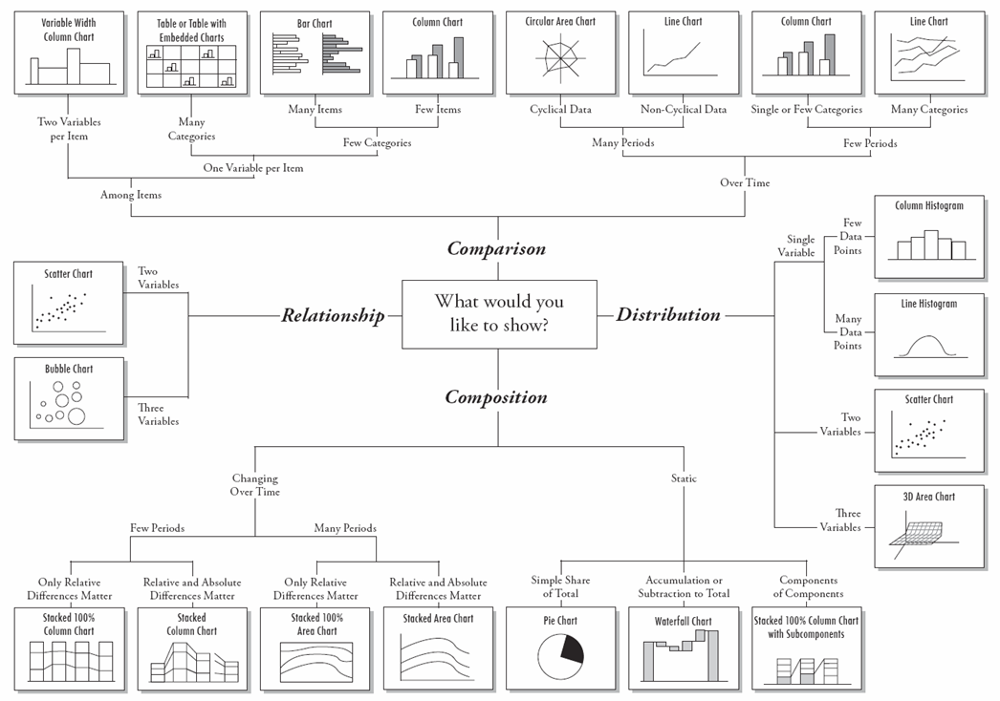

###3.2.1 Pandas Profiling/ YData Profiling

Dokumentation: https://www.influxdata.com/blog/pandas-profiling-tutorial/, https://docs.profiling.ydata.ai/latest/ oder https://github.com/ydataai/ydata-profiling?tab=readme-ov-file

In [6]:
# wir laden zuerst die notwendigen Libraries
!pip install ydata-profiling
from ydata_profiling import ProfileReport

profile = ProfileReport(df_spotify, title="Profiling Report")
profile

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.4/400.4 kB 7.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.7/296.7 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 59.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 679.7/679.7 kB 36.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 8.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.0 MB/s eta 0:00:00


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 21/21 [00:06<00:00,  3.26it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### 3.2.2 PygWalker

In diesem einführenden Notebook verwenden wir PyGWalker, ein Visualisierungs-Framework, das [Tableau](https://www.tableau.com/de-de) ähnelt.

Wir werden erst PygWalker im Notebook installieren und dann für Graphen verwenden. Eine ausführliche Doku zu PyGWalker finden Sie [hier](https://docs.kanaries.net/de/pygwalker), [hier](https://docs.kanaries.net/de/rath/data-viz/create-data-viz) oder [hier](https://www.datamasteryacademy.com/blog/pygwalker-tutorial-a-tableau-like-python-library-for-interactive-data-exploration-and-visualization).

Im u.a. Bild sehen Sie die verschiedenen Visualisierungen, die PyGWalker anbietet. In späteren Vorlesungen werden wir uns Matplot-Lib ansehen, das zwar deutlich detailliertere Graphiken erstellen kann, aber auch komplizierter zu bedienen ist.

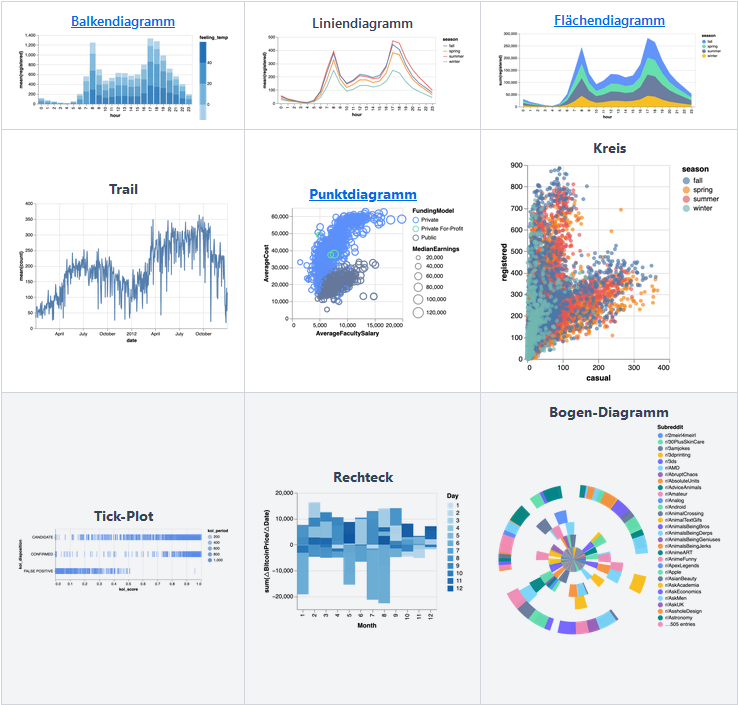

Quelle: [Link](https://docs.kanaries.net/de/rath/data-viz/create-data-viz)

In [7]:
# mit diesem Befehl installieren Sie pygwalker in dem Notebook.
# der parameter -q sorgt dafür, daß keine weiteren Bildschirmausgaben erfolgen
!pip install pygwalker -q
import pygwalker as pyg

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 43.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 956.2/956.2 kB 50.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.2/100.2 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 72.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 64.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.7/7.7 MB 98.7 MB/s eta 0:00:00


In [8]:
walker = pyg.walk(
    df_spotify,
    spec="./chart_meta_1.json",    # this json file will save your chart state, you need to click save button in ui mannual when you finish a chart, 'autosave' will be supported in the future.
    use_kernel_calc=True,          # set `use_kernel_calc=True`, pygwalker will use duckdb as computing engine, it support you explore bigger dataset(<=100GB).
)

Box(children=(HTML(value='\n<div id="ifr-pyg-00064937725de6e6By1hMlHLKIZ2bvug" style="height: auto">\n    <hea…

In [ ]:
# Speichere die Darstellung der most popular songs
walker.display_chart("Most popular songs")

In [ ]:
# Speichere die Darstellung der most popular songs
walker.display_chart("Genre vs. Popular")

##3.2.3: Matplotlib

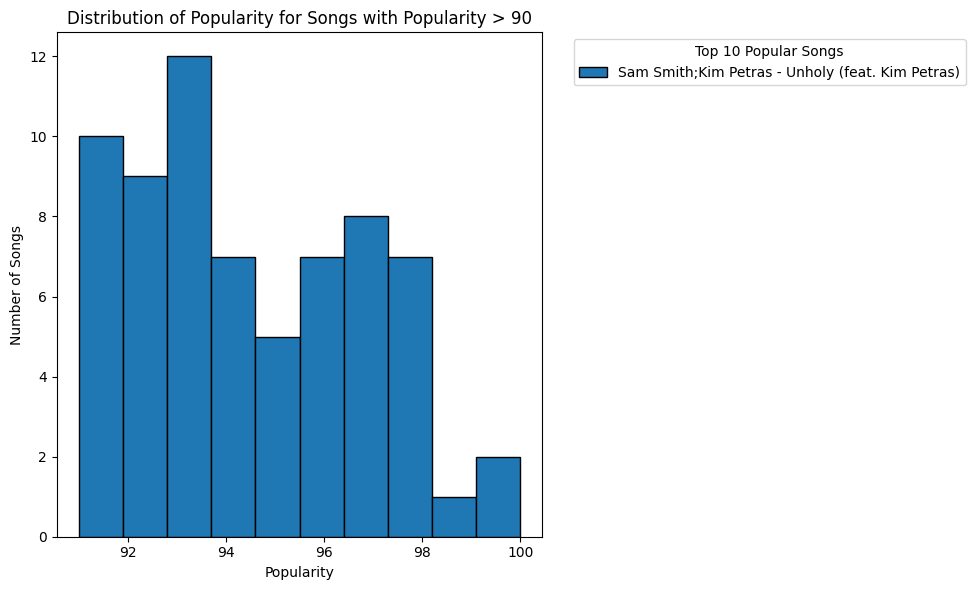

In [9]:
#Prompt: Erstelle mir ein Matplotlib-Histogramm über alle Einträge mit einer Popularität von mehr als 90.
# Dabei ist die x-Achse die Spalte "Popularity". Zeige zu jedem Eintrag das dazugehörige Feature "Artists" und "Trackname".
# Schreibe in eine Textzeile ein kurzes Ergebnis der Auswertung.

# Filtern Sie das DataFrame nach Liedern mit Popularität über 90
df_popular = df_spotify[df_spotify['popularity'] > 90]

# Erstellen Sie ein Histogramm der Popularität
plt.figure(figsize=(10, 6))
plt.hist(df_popular['popularity'], bins=10, edgecolor='black')

# Fügen Sie Titel und Achsenbeschriftungen hinzu
plt.title('Distribution of Popularity for Songs with Popularity > 90')
plt.xlabel('Popularity')
plt.ylabel('Number of Songs')

# Erstellen Sie eine Legende mit Künstlern und Tracknamen
# Da es viele Einträge geben kann, zeigen wir nur eine Auswahl in der Legende.
# Eine Legende für jeden einzelnen Punkt in einem Histogramm ist unpraktisch.
# Wir können stattdessen die top 10 beliebtesten Songs in der Legende anzeigen.
top_10_popular = df_popular.nlargest(10, 'popularity')
legend_labels = [f"{row['artists']} - {row['track_name']}" for index, row in top_10_popular.iterrows()]
plt.legend(legend_labels, title="Top 10 Popular Songs", bbox_to_anchor=(1.05, 1), loc='upper left')


plt.tight_layout()
plt.show()

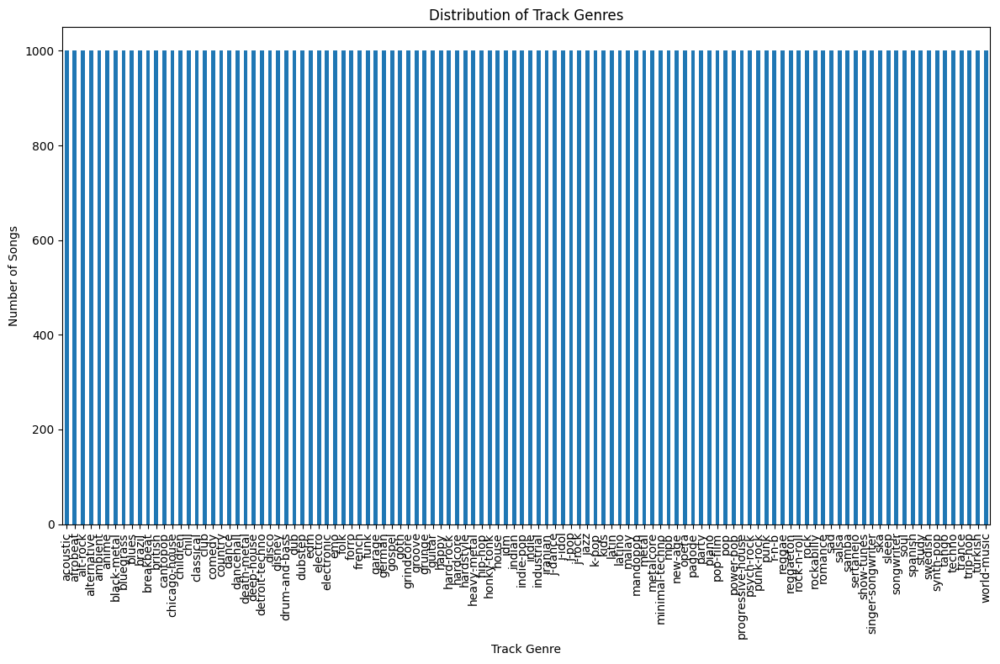

In [10]:
# Erstellen Sie ein Histogramm für die Spalte 'track_genre'.
# Da 'track_genre' eine kategoriale Spalte ist, verwenden wir value_counts(),
# um die Häufigkeit jedes Genres zu zählen, und plotten dann die Ergebnisse.
plt.figure(figsize=(12, 8)) # Legt die Größe des Diagramms fest
df_spotify['track_genre'].value_counts().plot(kind='bar') # Zählt die Werte und erstellt ein Balkendiagramm

# Fügen Sie Titel und Achsenbeschriftungen hinzu
plt.title('Distribution of Track Genres')
plt.xlabel('Track Genre')
plt.ylabel('Number of Songs')

# Verbessern Sie die Lesbarkeit der x-Achsenbeschriftungen
plt.xticks(rotation=90)

plt.tight_layout() # Passt das Layout an, um Überschneidungen zu vermeiden
plt.show() # Zeigt das Diagramm an

## 3.4: Feature Engineering:

Wir sehen einige Sachen, die wir ändern können.
So ist bspw. die Spalte **track_id** eher weniger interessant für unsere Auswertung. Auch könnte man die Länge eines Tracks (Spalte **duration_ms**) eher in Sekunden oder Minuten angeben.

Diese Operationen werden als **feature engineering** bezeichnet. Wir werden uns auch weitere im Detail ansehen.





In [11]:
# schauen wir uns die Datentypen im Detail an.
df_spotify.dtypes

,0
Unnamed: 0,int64
track_id,object
artists,object
album_name,object
track_name,object
popularity,int64
duration_ms,int64
explicit,bool
danceability,float64
energy,float64


Wir sehen hier die verschiedenen Datentypen für die Attribute des Datensatz.

Wir sehen daß wir wohl die Spalte track_id nicht brauchen, da das eine Spotify interne Größe ist.

In [12]:
# Lösche die Spalte 'track_id' aus dem DataFrame
df_spotify = df_spotify.drop('track_id', axis=1)

# Zeige die ersten Zeilen des geänderten DataFrames an, um die Entfernung zu bestätigen
display(df_spotify.head())

,Unnamed: 0,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


Auch die Spalte Unnamed brauchen wir wohl weniger...

In [13]:
# Lösche die Spalte 'track_id' aus dem DataFrame
df_spotify = df_spotify.drop("Unnamed: 0", axis=1)

# Zeige die ersten Zeilen des geänderten DataFrames an, um die Entfernung zu bestätigen
display(df_spotify.head())

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic


In [14]:
# Konvertiere die Spalte 'track_genre' in den Datentyp 'category'.
# Dies ist oft effizienter für Spalten mit einer begrenzten Anzahl von einzigartigen Werten (Kategorien).
df_spotify['track_genre'] = df_spotify['track_genre'].astype('category')

# Zeige die Datentypen des DataFrames erneut an, um die Änderung zu überprüfen.
display(df_spotify.dtypes)

,0
artists,object
album_name,object
track_name,object
popularity,int64
duration_ms,int64
explicit,bool
danceability,float64
energy,float64
key,int64
loudness,float64


Um das Notebook kurz zu halten, schauen wir uns nun kurz ausgewählte Darstellungen an. Wir werden dabei Hypothesen definieren und dann schauen ob wir diese widerlegen können.

**Hypothese 1:** in den 10 beliebtesten Liedern ist das Genre Pop am häufigsten vertreten

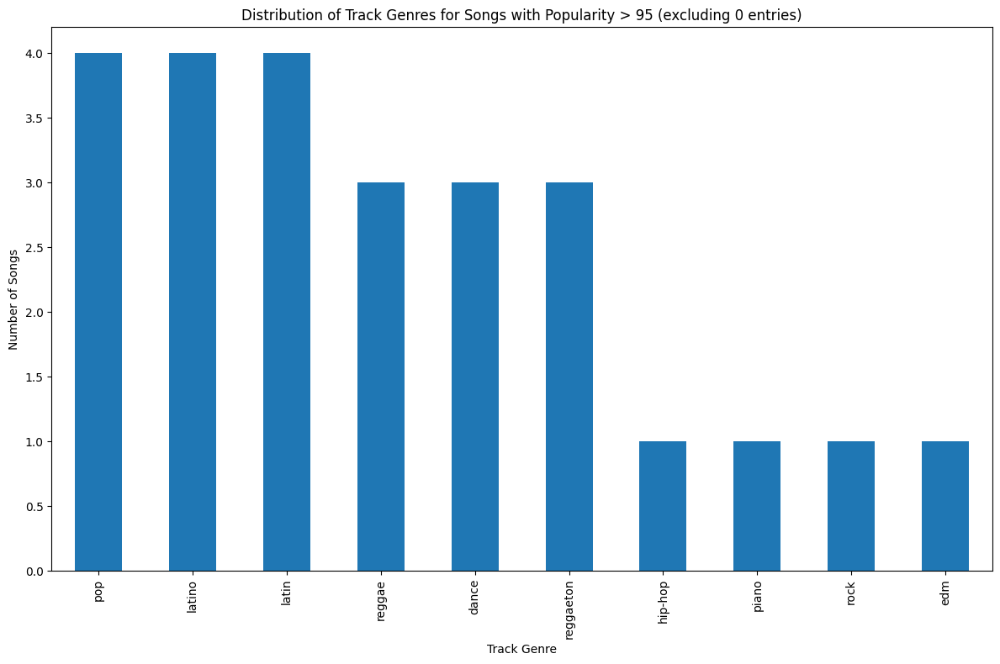

In [16]:
# Filtern Sie das DataFrame nach Liedern mit Popularität über 95. can you filter out all genres with 0 entries?
df_high_popularity = df_spotify[df_spotify['popularity'] > 95]

# Zählen Sie die Häufigkeit jedes Genres und filtern Sie diejenigen mit 0 Einträgen heraus
genre_counts = df_high_popularity['track_genre'].value_counts()
genre_counts = genre_counts[genre_counts > 0]

# Erstellen Sie ein Histogramm für die gefilterten Genre-Counts.
plt.figure(figsize=(12, 8)) # Legt die Größe des Diagramms fest
genre_counts.plot(kind='bar') # Plottet die gefilterten Zählungen als Balkendiagramm

# Fügen Sie Titel und Achsenbeschriftungen hinzu
plt.title('Distribution of Track Genres for Songs with Popularity > 95 (excluding 0 entries)')
plt.xlabel('Track Genre')
plt.ylabel('Number of Songs')

# Verbessern Sie die Lesbarkeit der x-Achsenbeschriftungen
plt.xticks(rotation=90)

plt.tight_layout() # Passt das Layout an, um Überschneidungen zu vermeiden
plt.show() # Zeigt das Diagramm an

[Generated by prompt from above:]

Auswertung des Histogramms 'Distribution of Track Genres for Songs with Popularity > 95':

Das Histogramm zeigt die Verteilung der Musikgenres für Lieder, die eine Popularität von über 95 aufweisen. Die x-Achse listet die verschiedenen Genres auf, während die y-Achse die Anzahl der Lieder in jedem dieser Genres angibt. Auffällig ist, dass einige Genres deutlich häufiger in dieser Kategorie sehr populärer Lieder vertreten sind als andere. Die Genres mit den höchsten Balken sind diejenigen, die in den Top-Hits überrepräsentiert sind. Dies hilft uns, **Hypothese 1** zu bewerten: ob Pop am häufigsten ist. Es scheint, dass 'pop' und 'latin' hier die dominantesten Genres sind, mit einer sehr hohen Anzahl von populären Liedern in diesen Kategorien.


Die Hypothese ist also teilweise richtig

**Hypothese 2:** Es gibt einen Zusammenhang zwischen Popularität, Länge des Lieds und Tempo

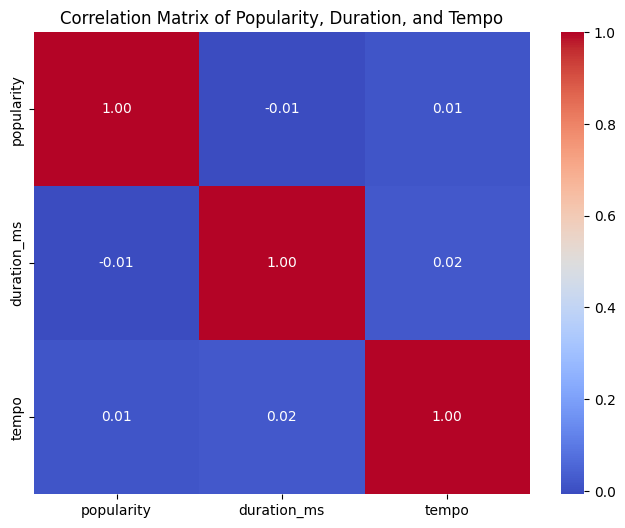

In [17]:
# Prompt: I want to see if there is a relation between popularity, duration and tempo.

# Wähle die relevanten Spalten aus
selected_features = df_spotify[['popularity', 'duration_ms', 'tempo']]

# Berechne die Korrelationsmatrix
correlation_matrix = selected_features.corr()

# Erstelle eine Heatmap der Korrelationsmatrix
plt.figure(figsize=(8, 6))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix of Popularity, Duration, and Tempo')
plt.show()

[Antwort GenAI-Modell:]

Let's investigate the relationship between popularity, duration, and tempo. I'll calculate the correlation matrix for these features and then visualize it with a heatmap, which can help us identify any strong linear relationships.

The heatmap shows the correlation matrix between popularity, duration_ms, and tempo. Here's a quick interpretation:

* Popularity vs. Duration_ms: The correlation coefficient is -0.0071, which is very close to zero. This indicates a negligible linear relationship between a song's popularity and its duration. In other words, longer or shorter songs don't seem to be significantly more or less popular based on this dataset.
* Popularity vs. Tempo: The correlation coefficient is 0.0132, also very close to zero. This suggests that there is almost no linear relationship between a song's popularity and its tempo. Whether a song is fast or slow doesn't appear to directly influence its popularity in a linear fashion.
* Duration_ms vs. Tempo: The correlation coefficient is 0.0243, which is again very low. This means there's a very weak linear relationship, if any, between a song's duration and its tempo.


In summary, based on this correlation matrix, there is **no strong linear relationship between any of these three features**. This suggests that Hypothesis 2, that there is a relationship between popularity, length of the song, and tempo, is largely not supported by a linear correlation in this dataset.

**Hypothese 3:** Es gibt Features, die eine sehr starke Abhängigkeit auf die Popularität haben

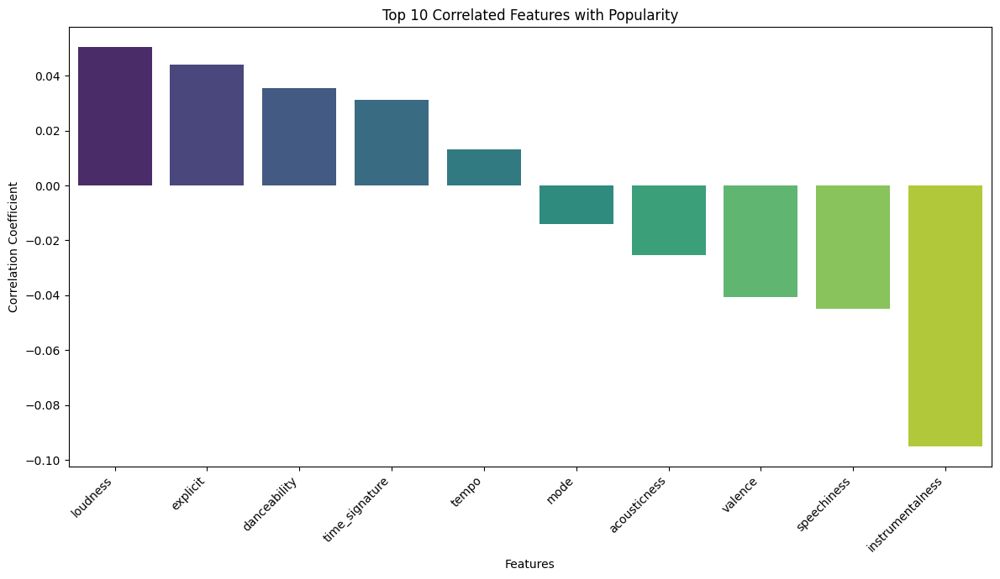

In [20]:
# Prompt: I want to know if there are features which have a strong impact on popularity

# Berechne die Korrelation aller numerischen Features mit 'popularity'
correlation_with_popularity = df_spotify.corr(numeric_only=True)['popularity'].sort_values(ascending=False)

# Entferne 'popularity' selbst aus der Liste, da es eine Korrelation von 1.0 hat
correlation_with_popularity = correlation_with_popularity.drop('popularity')

# Zeige die Top 10 korrelierten Features (positiv und negativ)
# Du kannst die Anzahl der Top-Features anpassen, die du sehen möchtest
top_correlated_features = pd.concat([
    correlation_with_popularity.head(5),  # Top 5 positiv korrelierte
    correlation_with_popularity.tail(5)   # Top 5 negativ korrelierte
])

plt.figure(figsize=(12, 7))
sns.barplot(x=top_correlated_features.index, y=top_correlated_features.values, hue=top_correlated_features.index, palette='viridis', legend=False)
plt.title('Top 10 Correlated Features with Popularity')
plt.xlabel('Features')
plt.ylabel('Correlation Coefficient')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

Das obige Balkendiagramm zeigt die 10 am stärksten mit der Popularität korrelierten Merkmale (5 positive und 5 negative). Die Länge des Balkens gibt die Stärke der Korrelation an (näher an 1 oder -1 bedeutet eine stärkere Korrelation). Merkmale mit positiven Korrelationen bewegen sich tendenziell in die gleiche Richtung wie die Popularität, während Merkmale mit negativen Korrelationen sich tendenziell in die entgegengesetzte Richtung bewegen.

[Output GenAI]

Regarding Hypothesis 3: Yes, there are several features that show a noticeable linear dependency on popularity, with loudness and instrumentalness being among the strongest. However, it's important to note that these correlations are still relatively modest (the highest being around 0.05), suggesting that popularity is influenced by a complex interplay of many factors, not just a few strongly correlated ones in a linear fashion.

Hypothese 3 kann also bestätigt werden.

**Hypothese 4:** Es gibt eine statistische Abhängigkeit zwischen Instrumentalness und Popularität.

Hierfür werden wir statistische Tests ansehen.

In [22]:
# Prompt: gibt es eine statistische Abhängigkeit zwischen Instrumentalness und Popularität?

# Berechne die Korrelation zwischen 'instrumentalness' und 'popularity'
correlation_instrumentalness_popularity = df_spotify['instrumentalness'].corr(df_spotify['popularity'])

print(f"Die Korrelation zwischen Instrumentalness und Popularität beträgt: {correlation_instrumentalness_popularity:.4f}")

# Erläuterung der Korrelation
if abs(correlation_instrumentalness_popularity) < 0.1:
    interpretation = "Dies deutet auf eine sehr schwache bis vernachlässigbare lineare Beziehung hin."
elif abs(correlation_instrumentalness_popularity) < 0.3:
    interpretation = "Dies deutet auf eine schwache lineare Beziehung hin."
elif abs(correlation_instrumentalness_popularity) < 0.5:
    interpretation = "Dies deutet auf eine moderate lineare Beziehung hin."
else:
    interpretation = "Dies deutet auf eine starke lineare Beziehung hin."

if correlation_instrumentalness_popularity < 0:
    direction = "(negativ, d.h. wenn das eine Feature zunimmt, nimmt das andere tendenziell ab)"
elif correlation_instrumentalness_popularity > 0:
    direction = "(positiv, d.h. wenn das eine Feature zunimmt, nimmt das andere tendenziell auch zu)"
else:
    direction = "(keine lineare Beziehung)"

print(f"\nInterpretation: {interpretation} {direction}")

Die Korrelation zwischen Instrumentalness und Popularität beträgt: -0.0951

Interpretation: Dies deutet auf eine sehr schwache bis vernachlässigbare lineare Beziehung hin. (negativ, d.h. wenn das eine Feature zunimmt, nimmt das andere tendenziell ab)


The correlation between 'instrumentalness' and 'popularity' is -0.0951.

Interpretation: This indicates a very weak to negligible linear relationship, and it's negative. This means that as 'instrumentalness' (the likelihood of a track containing no vocals) increases, 'popularity' tends to slightly decrease, but the effect is very small.

Regarding Hypothesis 4: While there is a slight negative linear correlation, it is very weak and almost negligible. Therefore, based on the linear correlation, we cannot confirm a strong statistical dependency between 'instrumentalness' and 'popularity'. Other types of relationships (non-linear) might exist, but a simple linear correlation doesn't show a significant one.

Hypothese 4 wird also abgelehnt.

Probieren Sie doch eigene Hypothesen aus!